In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly
import plotly.graph_objects as go
import datetime

In [2]:
df = pd.read_csv(r'C:\Users\Admin\Downloads\archive (20)\city_temperature.csv',low_memory=False)
df.head(5)

,Region,Country,State,City,Month,Day,Year,AvgTemperature
0,Africa,Algeria,NaN,Algiers,1,1,1995,64.2
1,Africa,Algeria,NaN,Algiers,1,2,1995,49.4
2,Africa,Algeria,NaN,Algiers,1,3,1995,48.8
3,Africa,Algeria,NaN,Algiers,1,4,1995,46.4
4,Africa,Algeria,NaN,Algiers,1,5,1995,47.9


In [3]:
df = df.drop_duplicates()
df.isnull().sum()

Region                  0
Country                 0
State             1448805
City                    0
Month                   0
Day                     0
Year                    0
AvgTemperature          0
dtype: int64

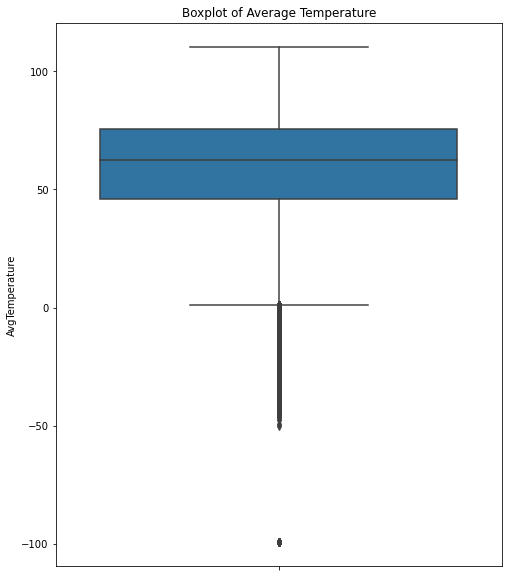

In [4]:
plt.figure(figsize = (8,10))
sns.boxplot(data = df,y = 'AvgTemperature')
_=plt.title("Boxplot of Average Temperature")

Outliers are present and can be seen in the figure above. Let's choose all the rows having 'AvgTemperature' greater than -70°F

In [5]:
df = df[df['AvgTemperature']>-70]

Let's check the range of Year-Month-Day in the dataset

In [6]:
df.sort_values(['Year','Month','Day'])

,Region,Country,State,City,Month,Day,Year,AvgTemperature
0,Africa,Algeria,NaN,Algiers,1,1,1995,64.2
13809,Africa,Benin,NaN,Cotonou,1,1,1995,81.2
23075,Africa,Central African Republic,NaN,Bangui,1,1,1995,75.3
32341,Africa,Congo,NaN,Brazzaville,1,1,1995,79.9
41606,Africa,Egypt,NaN,Cairo,1,1,1995,59.2
...,...,...,...,...,...,...,...,...
2862479,North America,US,Wisconsin,Green Bay,5,13,2020,38.5
2871744,North America,US,Wisconsin,Madison,5,13,2020,45.7
2881009,North America,US,Wisconsin,Milwaukee,5,13,2020,41.2
2890274,North America,US,Wyoming,Casper,5,13,2020,54.1


The data spans from Jan 1995 to May 2020

Since 2020 is incomplete, let's strip it off for the current analysis

In [7]:
df = df[df['Year']<2020]

Average temperature of the world over the years 1995 to 2019

In [8]:
data = df[['Year','AvgTemperature']].groupby('Year').mean()
linfit = np.polyfit(data.index,data['AvgTemperature'],deg=1)
linfit = linfit[0]*data.index + linfit[1]

fig = px.line(data,title='Average Temperature of the World from 1995 to 2019')
fig.add_trace(go.Scatter(x=data.index,y=linfit,name='Linear Fit'))

The overall trend of average temperature increases due to global warming

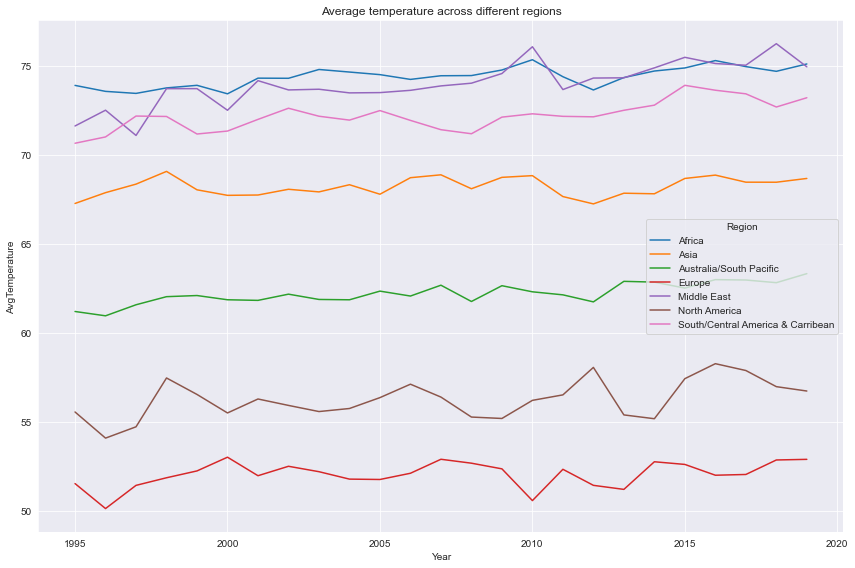

In [9]:
data = df[['Region','AvgTemperature','Year']].groupby(['Region','Year']).mean()
data = data.reset_index(level=0)

#plotting
sns.set_style('darkgrid')
plt.figure(figsize=(12,8))
sns.lineplot(data=data,hue='Region',x='Year',y='AvgTemperature')
_=plt.title('Average temperature across different regions')
plt.tight_layout()

Plot above shows the average temperatures labelled by region. Africa and Middle east are the hottest regions, and europe is the coldest.

Plot - Yearly average temperature graphs for different regions

In [10]:
#Preparing data
data = df[['Region','Month','AvgTemperature']]
data = data.groupby(['Region','Month']).mean()

months = {1:'Jan',2:'Feb',3:'Mar',4:'Apr',5:'May',6:'Jun',7:'Jul',8:'Aug',9:'Sep',10:'Oct',11:'Nov',12:"Dec"}
data = data.reset_index(level=1)

#Changing the month label from integer to name
data['Month'] = data.loc[:,'Month'].map(months)
data.head(5)

,Month,AvgTemperature
Region,,
Africa,Jan,72.540331
Africa,Feb,73.689526
Africa,Mar,74.704641
Africa,Apr,74.898640
Africa,May,74.982620


In [11]:
#plotting
regions = df['Region'].unique()
plot_holder = []
colors = ['green','red','firebrick','blue','teal','black','orange']
for i,region in enumerate(regions):
    plot = go.Bar(x=data.loc[region,'Month'],y=data.loc[region,'AvgTemperature'],name=region,visible = (i==0),marker_color=colors[i])
    plot_holder.append(plot)
fig = go.Figure(data = plot_holder)

buttons = [dict(label=region,method='update',args=[{'title':region,'visible':[True if j==i else False for j in range(len(regions))]}]) for i,region in enumerate(regions)]
updatemenus = list([
    dict(
    buttons=buttons,
    yanchor='top',
    xanchor='left')
])
fig.update_layout(updatemenus=updatemenus)


Africa and central america has nearly the same average temperature throught the year, Australia shows a reverse trend than others.

Let's display the highest and lowest recorded temperature in this dataset (1995 to 2020)



In [12]:
data1=df.sort_values(by=['AvgTemperature'],ascending=False).head(1)
data2=df.sort_values(by=['AvgTemperature'],ascending=True).head(1)
data = pd.concat([data1,data2],)
data.index = ['Highest','Lowest']
data

,Region,Country,State,City,Month,Day,Year,AvgTemperature
Highest,Middle East,Kuwait,NaN,Kuwait,8,1,2012,110.0
Lowest,North America,US,Alaska,Fairbanks,12,31,1999,-50.0


In [13]:
px.scatter_geo(lat=[29.3117,64.8378],lon=[29.3117,147.7164],text=['Kuwait','Fairbanks'],
               size=[0.5,0.5],color=[110,-50],color_continuous_scale='bluered')

Kuwait on 1st August 2012 recorded the highest temperature of 110°F and Fairbanks on 31st December 1999 recorded the lowest.

Top 10 coldest and hottest countries overall

In [14]:
data = df[['Country','AvgTemperature']].groupby('Country').mean().sort_values('AvgTemperature')
print('The top five coldest countries in the world are: ',data.index[:10].to_list())
print('The top five hottest countries in the world are: ',data.index[-10:].to_list())

The top five coldest countries in the world are:  ['Mongolia', 'Iceland', 'Norway', 'Canada', 'Finland', 'Latvia', 'Bolivia', 'Belarus', 'Sweden', 'Russia']
The top five hottest countries in the world are:  ['Guinea-Bissau', 'Philippines', 'Oman', 'Qatar', 'United Arab Emirates', 'Guyana', 'Indonesia', 'Thailand', 'Nigeria', 'Haiti']


Plot - Top ten coldest countries over the years

In [15]:
data = df[['Country','Year','AvgTemperature']].groupby(['Year','Country']).mean().sort_values('AvgTemperature').reset_index()
data = data.groupby('Year').apply(lambda group: group.iloc[:10]).reset_index(drop=True)
px.choropleth(data_frame=data,locationmode='country names',locations='Country',color='AvgTemperature',animation_frame='Year',title="Top ten coldest countries over the years")

Plot - Top ten hottest countries over the years

In [16]:
data = df[['Country','Year','AvgTemperature']].groupby(['Year','Country']).mean().sort_values('AvgTemperature',ascending=False).reset_index()
data = data.groupby('Year').apply(lambda group: group.iloc[:10]).reset_index(drop=True)
px.choropleth(data_frame=data,locationmode='country names',locations='Country',color='AvgTemperature',animation_frame='Year',title="Top ten hottest countries over the years")

Choropleth plot of countrywise average temperature over the years 1995 to 2019

In [17]:
data = df[['Country','Year','AvgTemperature']].groupby(['Country','Year']).mean().reset_index()
px.choropleth(data_frame=data,locations="Country",locationmode='country names',animation_frame="Year",color='AvgTemperature',color_continuous_scale = 'Turbo',title="Choropleth plot of countrywise average temperature over the years 1995 to 2019")


Let's narrow the analysis to NewYork city in USA¶


Selecting data points of NewYork city

In [18]:
#data["State"].value_counts()

In [19]:
data = df[df['Country'] == 'US']
NY = data.loc[data['State'] == 'New York',['Month','Day','Year','AvgTemperature']].reset_index(drop=True)
NY.head(3)

,Month,Day,Year,AvgTemperature
0,1,1,1995,35.4
1,1,2,1995,33.8
2,1,3,1995,26.7


Let's check if the temperature is recorded every day properly



In [20]:
size = NY.groupby(['Year','Month']).size().reset_index()
size_max = size[0].max()
size_min = size[0].min()
n = size_max - size_min +1
cmap = sns.color_palette("deep",n)
size = size.pivot(index='Year',columns='Month',values=0)
size.head(3)

Month,1,2,3,4,5,6,7,8,9,10,11,12
Year,,,,,,,,,,,,
1995,155,140,155,150,155,150,155,154,150,155,150,155
1996,155,145,155,150,153,134,155,155,150,155,150,155
1997,155,140,155,150,155,150,155,155,150,155,150,155


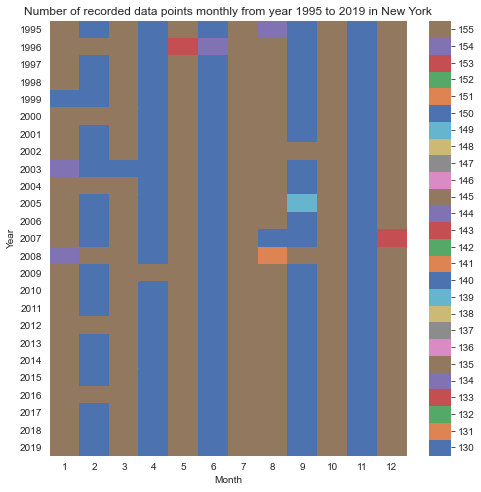

In [21]:
plt.figure(figsize=(8,8))
sns.heatmap(size,cmap=cmap)
_=plt.title('Number of recorded data points monthly from year 1995 to 2019 in New York')
colorbar = plt.gca().collections[0].colorbar

r = colorbar.vmax - colorbar.vmin
colorbar.set_ticks([colorbar.vmin + (r/n*(i+0.5)) for i in range(n)])
colorbar.set_ticklabels(range(size_min,size_max+1))

February column (Month = 2) shows leap years, but in certain other months, you can see the color mismatches. This is because some data is missing for that particular month

Let's create a datetime column and drop the month, year and day column

In [22]:
NY['Date'] = NY[['Year','Month','Day']].apply(lambda row:'-'.join([str(row['Year']),str(row['Month']),str(row['Day'])]),axis=1)
NY['Date'] = pd.to_datetime(NY['Date'])
NY = NY.drop(columns=['Month','Day','Year']).set_index('Date')
NY.head(3)

,AvgTemperature
Date,
1995-01-01,35.4
1995-01-02,33.8
1995-01-03,26.7


Plot of average temperature of the city of New York (1995-2019)

In [23]:
px.line(data_frame=NY,color_discrete_sequence=['grey'],title="Daily Average Temperature - New York (1995-2019)")

Rolling Statistics

In [24]:
roll_mean = NY.rolling(window=31).std()
roll_mean2 = NY.rolling(window=365).std()
fig = go.Figure()
fig.add_trace(go.Scatter(x=roll_mean.index,y=roll_mean['AvgTemperature'],marker=dict(color='red'),name='31DaysRolling'))
fig.add_trace(go.Scatter(x=roll_mean2.index,y=roll_mean2['AvgTemperature'],marker=dict(color='green'),name='365DaysRolling'))
fig.update_layout(dict(title='Rolling Std'))

Seasonal Decompose

In [25]:
from statsmodels.tsa.seasonal import seasonal_decompose

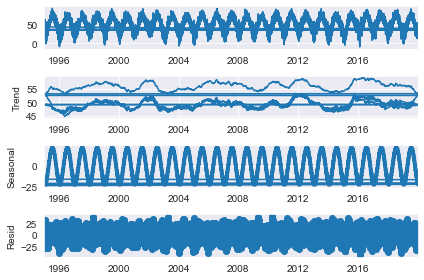

In [26]:
decompose = seasonal_decompose(NY,period=365)
decompose.plot();

Dickey Fuller Test

Let's perform a Dickey Fuller test to verify the stationarity

Null hypothesis: The time series data is non stationary

In [27]:
from statsmodels.tsa.stattools import adfuller

In [28]:
adf = adfuller(x=NY['AvgTemperature'])
print('pvalue:',adf[1])
print('adf:',adf[0])
print('usedlag:',adf[2])
print('nobs:',adf[3])
print('critical_values:',adf[4])
print('icbest:',adf[5])

pvalue: 0.0
adf: -21.415254710208703
usedlag: 56
nobs: 45500
critical_values: {'1%': -3.4304937289881634, '5%': -2.861603525122512, '10%': -2.566803812345852}
icbest: 289053.8498620108


The pvalue is very small, close to 0. Hence we can reject our null hypothesis. The data is stationary

LSTM Model Creation

In [29]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM,Dense
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.callbacks import EarlyStopping

Train - Test - Split: Choosing 2019 data for testing and remaining for training

In [30]:
test = NY[NY.index>'2019']
train = NY[NY.index<'2019']

Scaling train data and test data for LSTM Input

In [31]:
scaler = MinMaxScaler()
train = scaler.fit_transform(train)
test = scaler.transform(test)

In [32]:
time_steps = 20
features = 1

train_gen = TimeseriesGenerator(train,train,time_steps,batch_size=32)
test_gen = TimeseriesGenerator(test,test,time_steps,batch_size=32)

Defining a sequential model

In [33]:
model = Sequential()
model.add(LSTM(64,activation='relu',input_shape=(time_steps,features),return_sequences=True))
model.add(LSTM(32,activation='relu'))
model.add(Dense(1,activation='relu'))
model.compile(optimizer='adam',loss='mse')

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 20, 64)            16896     
_________________________________________________________________
lstm_1 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dense (Dense)                (None, 1)                 33        
Total params: 29,345
Trainable params: 29,345
Non-trainable params: 0
_________________________________________________________________


Defining Callbacks

In [34]:
early_stop = EarlyStopping(patience=5)

Fitting the model

In [35]:
model.fit(x=train_gen,epochs=40,callbacks=[early_stop],validation_data=test_gen)

#Save the model
model.save('LSTMAvgTemp.h5')

Epoch 1/40
1366/1366 [==============================] - 15s 10ms/step - loss: 0.3724 - val_loss: 0.3724
Epoch 2/40
1366/1366 [==============================] - 16s 11ms/step - loss: 0.3724 - val_loss: 0.3724
Epoch 3/40
1366/1366 [==============================] - 16s 11ms/step - loss: 0.3724 - val_loss: 0.3724
Epoch 4/40
1366/1366 [==============================] - 16s 11ms/step - loss: 0.3724 - val_loss: 0.3724
Epoch 5/40
1366/1366 [==============================] - 15s 11ms/step - loss: 0.3724 - val_loss: 0.3724
Epoch 6/40
1366/1366 [==============================] - 16s 11ms/step - loss: 0.3724 - val_loss: 0.3724


Let's input X values in the test generator to the model and collect it's predictions

Let's also collect the original targets from the test generator

In [36]:
predict = model.predict(test_gen)
test_targets = test_gen.targets[test_gen.start_index:test_gen.end_index+1]

Let's inverse transform the scaled results

In [37]:
predict = scaler.inverse_transform(predict).ravel()
test_targets = scaler.inverse_transform(test_targets).ravel()

# Model Evaluation

The predictions of the model for the year 2019 are plotted with the actual target values of 2019

In [38]:
from sklearn.metrics import mean_squared_error

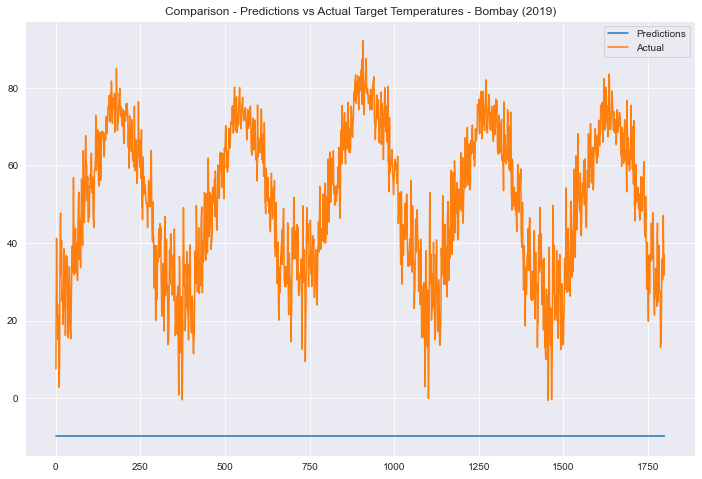

In [39]:
_,ax=plt.subplots(1,1,figsize=(12,8))
sns.lineplot(x=range(len(predict)),y=predict,ax=ax,label='Predictions')
sns.lineplot(x=range(len(test_targets)),y=test_targets,ax=ax,label='Actual')
plt.legend()
_=plt.title('Comparison - Predictions vs Actual Target Temperatures - Bombay (2019)')

In [40]:
print('The RMSE Score is:',format(np.sqrt(mean_squared_error(predict,test_targets)),'.2f'))

The RMSE Score is: 63.16


Forecasting beyond 2019

Select the last 'time_steps' values of average temperature from test data. It can be used to forecast further.

In [41]:
data = NY.iloc[-time_steps:].to_numpy() #2D Array
data = scaler.transform(data)

#expand to include batch dimension
data = np.expand_dims(data,0)

#record the last date of observartion from the data
date = NY.index[-1]

date_store = NY.iloc[-time_steps:].index.to_list()

#forecasting
forecasts=10
for i in range(forecasts):
    predicted = model.predict(data[:,-20:,:])
    date = date+datetime.timedelta(days=1)
    data = np.append(data,[predicted],axis=1)
    date_store.append(date)
data = scaler.inverse_transform(data.reshape(1,-1))
forecast_df = pd.DataFrame(index=date_store[time_steps-1:],data={'AvgTemperature':data.ravel()[time_steps-1:]})

Let's print and plot the forecast_df

The first datapoint in forecast_df is not predicted. It is borrowed from the given data to ensure continuity while plotting

In [42]:
forecast_df

,AvgTemperature
2019-12-31,36.9
2020-01-01,-9.8
2020-01-02,-9.8
2020-01-03,-9.8
2020-01-04,-9.8
2020-01-05,-9.8
2020-01-06,-9.8
2020-01-07,-9.8
2020-01-08,-9.8
2020-01-09,-9.8


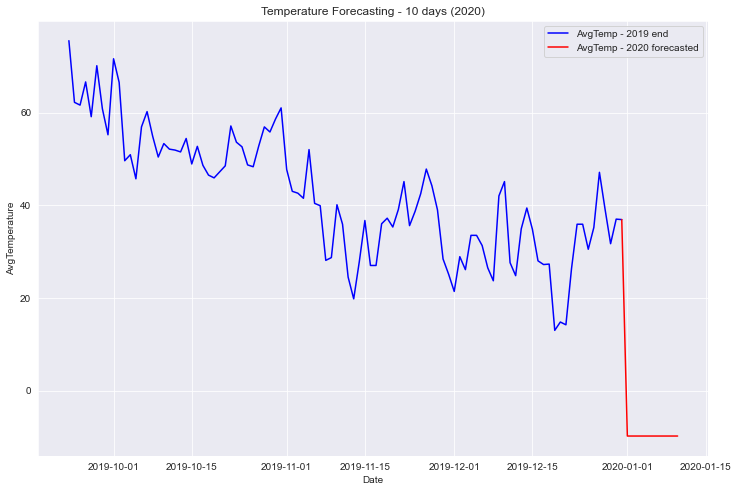

In [43]:
_,ax=plt.subplots(1,1,figsize=(12,8))
sns.lineplot(data=NY.iloc[-100:,:],y='AvgTemperature',x=NY.iloc[-100:,:].index,color='blue',ax=ax,label='AvgTemp - 2019 end')
sns.lineplot(data=forecast_df,y='AvgTemperature',x=forecast_df.index,color='red',ax=ax,label= 'AvgTemp - 2020 forecasted')
_=plt.title(f'Temperature Forecasting - {forecasts} days (2020)')

# Seasonal ARIMA Model

In [44]:
!pip3 install -q pmdarima
from pmdarima.arima import auto_arima
from dateutil.relativedelta import relativedelta

The data should be downsampled to train the Seasonal ARIMA model faster. So here we are downsampling the data from 
daily to monthly frequency. If downsampling is not performed, the model created will be very huge in this case

In [45]:
NY_monthly = NY.resample('M').mean()
NY_monthly.head(5)

,AvgTemperature
Date,
1995-01-31,32.440000
1995-02-28,24.695000
1995-03-31,39.656129
1995-04-30,44.064000
1995-05-31,57.931613


In [46]:
data =[go.Scatter(x=NY.index,y=NY['AvgTemperature'],name='AvTemperature-Daily',marker=dict(color='grey')),go.Scatter(x= NY_monthly.index,y=NY_monthly['AvgTemperature'],name='AvgTemperature-Monthly',marker=dict(color='red'))]
fig = go.Figure(data)

buttons = [dict(label='Both',method='restyle',args=[{'visible':[True,True]}]),
           dict(label='Daily',method='restyle',args=[{'visible':[True,False]}]),
           dict(label='Monthly',method='restyle',args=[{'visible':[False,True]}])]

updatemenus=[dict(type="buttons",direction='down',buttons=buttons)]
fig.update_layout(updatemenus=updatemenus,title='Average Temperature - Daily and Monthly - New York')

The auto arima function can automatically determine arima parameters and model

The data is seasonal with the frequency of 12 months

In [47]:
#using default auto_arima arguments
model = auto_arima(NY_monthly,seasonal=True,m=12)

Storing date and temperature of the last row so that forecast plot can be made continuous

In [48]:
date = NY_monthly.index[-1]
last_val = NY_monthly.iloc[-1].to_numpy()

Forecasting for the first 5 months in 2020

In [49]:
forecasts=5
date_store = [(date + relativedelta(months=i)) for i in range(0,forecasts+1)]

predict = model.predict(forecasts)
predict =  np.append(last_val,predict)
forecast_df = pd.DataFrame(data=predict,index=date_store,columns=['AvgTemperature'])
forecast_df.head(5)

,AvgTemperature
2019-12-31,33.088387
2020-01-31,26.970792
2020-02-29,29.056717
2020-03-31,35.785124
2020-04-30,47.665806


Plotting results

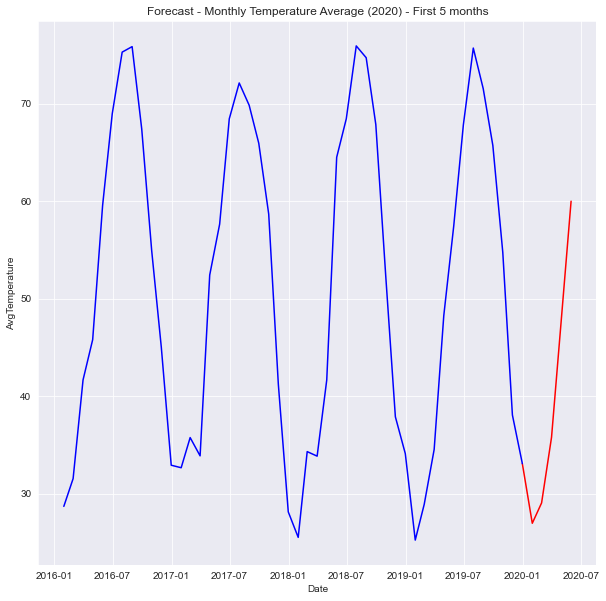

In [50]:
_,ax=plt.subplots(1,1,figsize=(10,10))
sns.lineplot(data=forecast_df['AvgTemperature'],ax=ax,color='red')
sns.lineplot(data=NY_monthly['AvgTemperature'][-4*12:],ax=ax,color='blue')
_=plt.title(f'Forecast - Monthly Temperature Average (2020) - First {forecasts} months')